In [1]:
%matplotlib inline

In [2]:
import numpy as np
import matplotlib 
import matplotlib.pyplot as plt 
from sklearn import datasets
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

import pandas as pd
import pandas_profiling as pp

from support import plot_event

In [3]:
# options pour pandas
pd.set_option("display.max_columns",30)
pd.set_option('display.max_rows', 30)

## Jeu de données des séries temporelles de pluie

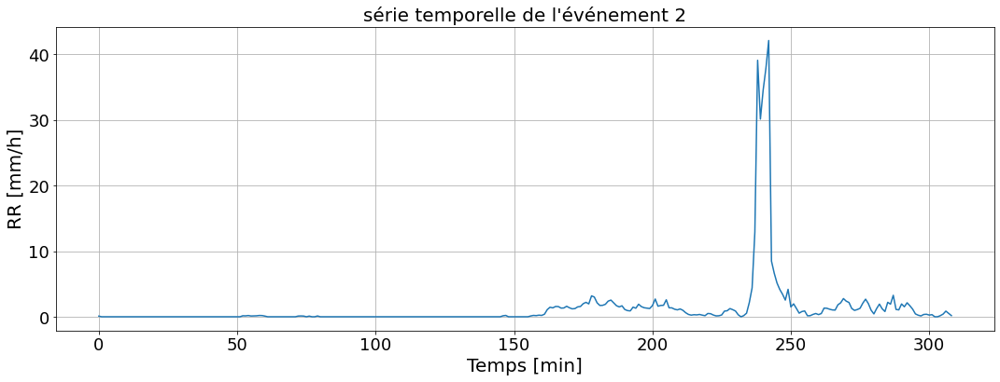

In [4]:
plt.figure(figsize=(18,6))
plot_event(1)
# pour afficher l'événement 2

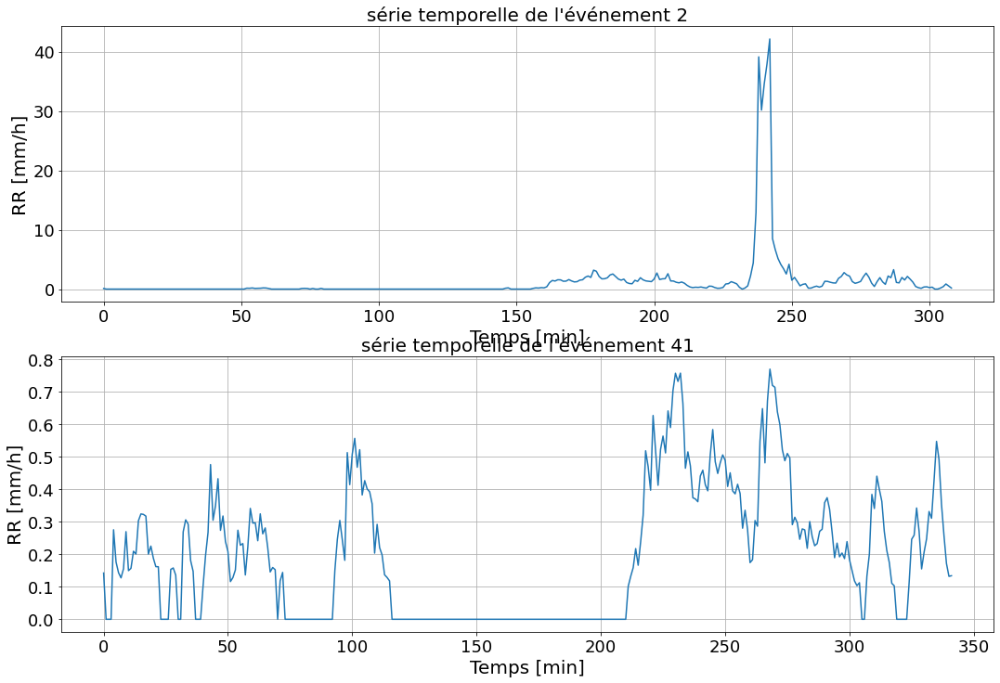

In [5]:
listeDEvenements = [1,40] 
# pour afficher les deux événements 2 et 41
plt.figure(figsize=(18,6*len(listeDEvenements)))
plot_event(listeDEvenements)

Ce jeu de données est composé de 234 événementsde pluie/individus caractérisés par 23 mesures/variables.

In [6]:
nomDesVariables_ = ['Durée de l’événement',
                    'Moyenne du tauxde pluie',
                    'Durée non pluvieuse intra-événement',
                    'premier quartile',
                    'Médiane',
                    'Troisième quartile',
                    'Temps inter-événement précédent',
                    'Moyenne du taux de pluie / pluie',
                    'Écart-type du taux de pluie s/événement',
                    'Mode',
                    'Maximum du taux de pluie',
                    'Pourcentage de non pluie intra évènement',
                    'cumul d’eau',
                    'Coefficient de variation du taux de pluie d’ordre c_1=0.5',
                    'Coefficient de variation du taux de pluie d’ordre c_2=1',
                    'Coefficient de variation du taux de pluie d’ordre c_3=2',
                    'Coefficient de variation normalisé du taux de pluie d’ordre c_N1=1',
                    'Coefficient de variation normalisé du taux de pluie d’ordre c_N2=2',
                    'Coefficient de variation normalisé du taux de pluie d’ordre c_N3=3',
                    'Coefficient de variation du taux de pluie d’ordre C=2 seuillé à S=0.3',
                    'Paramètre de convectivité beta_L1=0.3',
                    'Paramètre de convectivité beta_L2=1',
                    'Paramètre de convectivité beta_L3=3']
nomDesVariables = ['$D_e$',
                    '$R_m$',
                    '$D_d$',
                    '$Q_1$',
                    '$Q_2$',
                    '$Q_3$',
                    '$IET_p$',
                    '$R_{m,r}$',
                    '$\sigma_R$',
                    '$M_0$',
                    '$R_{\max}$',
                    '$D_{d\%e}$',
                    '$R_d$',
                    '$P_{c1}$',
                    '$P_{c2}$',
                    '$P_{c3}$',
                    '$P_{CN_1}$',
                    '$P_{CN_2}$',
                    '$P_{CN_3}$',
                    '$P_{S,C}$',
                    '$\\beta_{L1}$',
                    '$\\beta_{L2}$',
                    '$\\beta_{L3}$']

In [7]:
indices_reduits = [0, 8, 10, 13, 12] 
choix = "complet"
#choix = "complet_norme"
#choix = "reduit"
#choix = "reduit_norme"
if choix == "complet":
    df_pluie=pd.read_csv('x.txt',sep='\s+', 
                     header=None,decimal=',',
                  names=nomDesVariables)
elif choix == "complet_norme":
    #for i in range(len(nomDesVariables)):
    #    nomDesVariables[i] += 'n'
    nomDesVariables = [nomDesVariables[i][:-1]+'n'+nomDesVariables[i][-1] for i in range(len(nomDesVariables))]
    df_pluie=pd.read_csv('xn.txt',sep='\s+', 
                     header=None,decimal=',',
                  names=nomDesVariables)
elif choix == "reduit":
    df_pluie=pd.read_csv('x.txt',sep='\s+', 
                     header=None,decimal=',',
                  names=nomDesVariables)
    df_pluie = df_pluie[[nomDesVariables[i] for i in indices_reduits]]
elif choix == "reduit_norme":
    nomDesVariables = [nomDesVariables[i][:-1]+'n'+nomDesVariables[i][-1] for i in indices_reduits]
        
    df_pluie=pd.read_csv('xn5.txt',sep='\s+', 
                     header=None,decimal=',',
                  names=nomDesVariables)
data = df_pluie.values

In [8]:
df_pluie

,$D_e$,$R_m$,$D_d$,$Q_1$,$Q_2$,$Q_3$,$IET_p$,"$R_{m,r}$",$\sigma_R$,$M_0$,$R_{\max}$,$D_{d\%e}$,$R_d$,$P_{c1}$,$P_{c2}$,$P_{c3}$,$P_{CN_1}$,$P_{CN_2}$,$P_{CN_3}$,"$P_{S,C}$",$\beta_{L1}$,$\beta_{L2}$,$\beta_{L3}$
0,630,0.537523,174,0.000000,0.316573,0.618634,40,0.742630,1.298408,0.000000,20.218657,0.276190,5.643989,179.215244,113.088628,495.773846,0.284469,0.179506,0.786943,493.080644,0.974088,0.486876,0.266087
1,309,1.296351,142,0.000000,0.138217,1.257375,530,2.398637,4.760198,0.000000,42.119316,0.459547,6.676206,111.913664,153.267428,2077.405464,0.362180,0.496011,6.722995,2076.211115,0.990273,0.936991,0.605848
2,83,1.019498,31,0.000000,0.155255,0.654592,78,1.627276,2.132923,0.000000,10.902938,0.373494,1.410306,46.161059,59.426128,200.672046,0.556157,0.715977,2.417735,198.772931,0.970833,0.868778,0.691536
3,412,0.264079,109,0.000000,0.225754,0.401234,535,0.359078,0.246462,0.000000,1.283253,0.264563,1.813343,82.838816,27.034653,4.349852,0.201065,0.065618,0.010558,3.019851,0.898969,0.070579,0.000000
4,396,0.534855,35,0.227919,0.479513,0.728286,454,0.586710,0.386947,0.000000,1.872005,0.088384,3.530041,102.834084,35.830427,7.502918,0.259682,0.090481,0.018947,6.519295,0.961921,0.317393,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
229,375,0.712747,50,0.195857,0.550069,1.147278,1667,0.822400,0.616581,0.000000,3.150854,0.133333,4.454667,146.870299,83.108666,42.811726,0.391654,0.221623,0.114165,41.185103,0.974686,0.611704,0.011789
230,86,0.889235,15,0.211703,0.653228,1.393413,52,1.077101,0.836698,0.000000,3.254797,0.174419,1.274570,40.950625,27.821727,18.674781,0.476170,0.323508,0.217149,17.948527,0.990434,0.800362,0.084102
231,242,0.352950,86,0.000000,0.220851,0.615628,48,0.547525,0.428289,0.000000,2.518346,0.355372,1.423564,59.679749,28.671239,11.087271,0.246611,0.118476,0.045815,9.845281,0.952646,0.268573,0.000000
232,108,0.790337,0,0.456726,0.691978,1.054932,6434,0.790337,0.489424,0.143405,2.692661,0.000000,1.422606,46.650819,25.611452,13.069030,0.431952,0.237143,0.121010,12.861166,0.987900,0.493160,0.000000


In [9]:
pp.ProfileReport(df_pluie)

#### Une projection en 2D (ACP)
(C'est rapide mais c'est l'idée.)

  Ce jeu a donc la particularité d'être dans un espace de dimension quatre abritant trois espèces de fleurs presque tout en étant preque séparable en choisissant un plan en 2D ([un tutoriel mettant en avant une ACP](https://scikit-learn.org/stable/auto_examples/decomposition/plot_pca_iris.html))

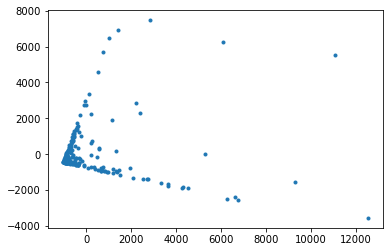

In [10]:
pca = PCA(n_components=2)
pca.fit(data)
X_pca = pca.transform(data)
plt.plot(X_pca[:,0],X_pca[:,1],'.')

#### Une projection en 2D (TSNE)
(C'est rapide mais c'est l'idée.)

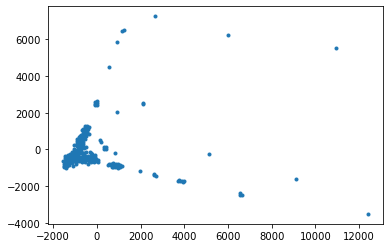

In [11]:
tsne = TSNE(n_components=2, init='pca', random_state=0)
X_tsne = tsne.fit_transform(data)
plt.plot(X_tsne[:,0],X_tsne[:,1],'.')

***
**On est jamais mieux servi que par soi-même.**  
**If you want something done right, do it yourself.**

[pandas](https://pandas.pydata.org/) - [Numpy and Scipy](https://docs.scipy.org/doc/) - [matplotlib](https://matplotlib.org/) - [scikit-learn](http://scikit-learn.org/stable/) - [seaborn](https://seaborn.pydata.org/)